In [1]:
class HashTable:
    def __init__(self, size=10):
        self.size = size
        self.table = [None] * self.size
        self.count = 0  # Tracks the number of elements in the table
    
    def _hash(self, key):
        """Compute a hash for the given key."""
        return hash(key) % self.size

    def _resize(self):
        """Resize the table when it gets too full."""
        new_size = self.size * 2
        new_table = [None] * new_size
        
        for item in self.table:
            if item is not None:
                key, value = item
                new_index = hash(key) % new_size
                while new_table[new_index] is not None:
                    new_index = (new_index + 1) % new_size
                new_table[new_index] = (key, value)

        self.size = new_size
        self.table = new_table

    def insert(self, key, value):
        """Insert a new key-value pair into the table."""
        if self.count / self.size > 0.7:  # Resize if load factor exceeds 0.7
            self._resize()

        index = self._hash(key)
        while self.table[index] is not None:
            stored_key, _ = self.table[index]
            if stored_key == key:  # Update the value if key exists
                self.table[index] = (key, value)
                return
            index = (index + 1) % self.size  # Linear probing

        self.table[index] = (key, value)
        self.count += 1

    def search(self, key):
        """Search for a value by its key."""
        index = self._hash(key)
        start_index = index  # To avoid infinite loops
        while self.table[index] is not None:
            stored_key, value = self.table[index]
            if stored_key == key:
                return value
            index = (index + 1) % self.size
            if index == start_index:
                break  # We've looped through the entire table

        return None  # Key not found

    def delete(self, key):
        """Delete a key-value pair from the table."""
        index = self._hash(key)
        start_index = index
        while self.table[index] is not None:
            stored_key, _ = self.table[index]
            if stored_key == key:
                self.table[index] = None  # Mark as deleted
                self.count -= 1
                return
            index = (index + 1) % self.size
            if index == start_index:
                break  # We've looped through the entire table

        return None  # Key not found

    def __repr__(self):
        return f"{[item for item in self.table if item is not None]}"

# Example Usage
ht = HashTable()
ht.insert("apple", 1)
ht.insert("banana", 2)
ht.insert("orange", 3)

print("Hash Table after insertions:", ht)
print("Search for 'banana':", ht.search("banana"))
ht.delete("banana")
print("Hash Table after deletion:", ht)
print("Search for 'banana' after deletion:", ht.search("banana"))


Hash Table after insertions: [('apple', 1), ('orange', 3), ('banana', 2)]
Search for 'banana': 2
Hash Table after deletion: [('apple', 1), ('orange', 3)]
Search for 'banana' after deletion: None


In [5]:
class HashTable:
    def __init__(self, size=17):  # Prime number as initial size for better distribution
        self.size = size
        self.table = [None] * self.size
        self.count = 0
        self.deleted = object()  # Unique object to mark deleted entries

    def _hash(self, key):
        """Compute a hash for the given key."""
        return hash(key) % self.size

    def _resize(self):
        """Resize the table when it gets too full."""
        old_table = self.table
        new_size = self.size * 2
        self.size = new_size
        self.table = [None] * new_size
        self.count = 0

        for item in old_table:
            if item is not None and item is not self.deleted:
                key, value = item
                self.insert(key, value)

    def insert(self, key, value):
        """Insert a new key-value pair into the table."""
        if self.count / self.size > 0.7:  # Resize if load factor exceeds 0.7
            self._resize()

        index = self._hash(key)
        start_index = index  # To prevent infinite loops
        while self.table[index] is not None and self.table[index] is not self.deleted:
            stored_key, _ = self.table[index]
            if stored_key == key:
                self.table[index] = (key, value)
                return
            index = (index + 1) % self.size
            if index == start_index:
                break

        self.table[index] = (key, value)
        self.count += 1

    def search(self, key):
        """Search for a value by its key."""
        index = self._hash(key)
        start_index = index
        while self.table[index] is not None:
            if self.table[index] is not self.deleted:
                stored_key, value = self.table[index]
                if stored_key == key:
                    return value
            index = (index + 1) % self.size
            if index == start_index:
                return None

    def delete(self, key):
        """Delete a key-value pair from the table."""
        index = self._hash(key)
        start_index = index
        while self.table[index] is not None:
            if self.table[index] is not self.deleted:
                stored_key, _ = self.table[index]
                if stored_key == key:
                    self.table[index] = self.deleted
                    self.count -= 1
                    return
            index = (index + 1) % self.size
            if index == start_index:
                return None

    def __repr__(self):
        return f"{[item for item in self.table if item is not None and item is not self.deleted]}"

# Example Usage
ht = HashTable()
ht.insert("apple", 1)
ht.insert("banana", 2)
ht.insert("orange", 3)

print("Hash Table after insertions:", ht)
print("Search for 'banana':", ht.search("banana"))
ht.delete("banana")
print("Hash Table after deletion:", ht)
print("Search for 'banana' after deletion:", ht.search("banana"))


Hash Table after insertions: [('orange', 3), ('apple', 1), ('banana', 2)]
Search for 'banana': 2
Hash Table after deletion: [('orange', 3), ('apple', 1)]
Search for 'banana' after deletion: None


In [13]:
class HashTable:
    def __init__(self, size=7):  # Using a prime number to reduce collisions
        self.size = size
        self.table = [[] for _ in range(self.size)]

    def _division_hash(self, key):
        hash_value = hash(key) % self.size
        print(f"Division hash for key '{key}': {hash_value}")
        return hash_value

    def _multiplication_hash(self, key, A=0.618033):  # A is the fractional part of the golden ratio
        hash_value = hash(key)
        fractional_part = hash_value * A % 1
        result = int(self.size * fractional_part)
        print(f"Multiplication hash for key '{key}' (fractional part: {fractional_part}): {result}")
        return result

    def _folding_hash(self, key):
        str_key = str(key)
        key_parts = [str_key[i:i+2] for i in range(0, len(str_key), 2)]
        sum_parts = sum(int(part) for part in key_parts if part.isdigit())
        hash_value = sum_parts % self.size
        print(f"Folding hash for key '{key}' (sum of parts: {sum_parts}): {hash_value}")
        return hash_value

    def insert(self, key, value, method='division'):
        if method == 'division':
            index = self._division_hash(key)
        elif method == 'multiplication':
            index = self._multiplication_hash(key)
        elif method == 'folding':
            index = self._folding_hash(key)
        else:
            raise ValueError("Unsupported hash method")

        # Chaining: add the key-value pair to the list at the computed index with its hash
        for i, (k, v, h) in enumerate(self.table[index]):
            if k == key:
                self.table[index][i] = (key, value, h)  # Update existing key
                print(f"Updated key '{key}' with value '{value}' at index {index}")
                return
        self.table[index].append((key, value, index))  # Store with hash index
        print(f"Inserted key '{key}' with value '{value}' at index {index}")

    def __repr__(self):
        # Now printing the hash values that were computed during insertion
        table_representation = []
        for i, bucket in enumerate(self.table):
            if bucket:
                bucket_repr = []
                for key, value, hash_value in bucket:
                    bucket_repr.append(f"('{key}', {value}, hash={hash_value})")
                table_representation.append(f"Bucket {i}: {bucket_repr}")
            else:
                table_representation.append(f"Bucket {i}: []")
        return "\n".join(table_representation)

# Example Usage
ht = HashTable()
ht.insert("apple", 1, method='division')
ht.insert("banana", 2, method='multiplication')
ht.insert("orange", 3, method='folding')

print("Hash Table after insertions:")
print(ht)


Division hash for key 'apple': 3
Inserted key 'apple' with value '1' at index 3
Multiplication hash for key 'banana' (fractional part: 0.0): 0
Inserted key 'banana' with value '2' at index 0
Folding hash for key 'orange' (sum of parts: 0): 0
Inserted key 'orange' with value '3' at index 0
Hash Table after insertions:
Bucket 0: ["('banana', 2, hash=0)", "('orange', 3, hash=0)"]
Bucket 1: []
Bucket 2: []
Bucket 3: ["('apple', 1, hash=3)"]
Bucket 4: []
Bucket 5: []
Bucket 6: []


In [9]:
import xxhash

class HashTable:
    def __init__(self, size=10):  # Using a prime number to reduce collisions
        self.size = size
        self.table = [[] for _ in range(self.size)]

    def _xxhash(self, key):
        # Converting the key to string before hashing, as xxhash works on strings
        if not isinstance(key, str):
            key = str(key)
        # Using xxhash to hash the key, and mod by size to keep it within table bounds
        hash_value = xxhash.xxh32(key).intdigest() % self.size
        print(f"XXHash for key '{key}': {hash_value}")
        return hash_value

    def _division_hash(self, key):
        hash_value = hash(key) % self.size
        print(f"Division hash for key '{key}': {hash_value}")
        return hash_value

    def _multiplication_hash(self, key, A=0.618033):  # A is the fractional part of the golden ratio
        hash_value = hash(key)
        fractional_part = hash_value * A % 1
        result = int(self.size * fractional_part)
        print(f"Multiplication hash for key '{key}' (fractional part: {fractional_part}): {result}")
        return result

    def _folding_hash(self, key):
        str_key = str(key)
        key_parts = [str_key[i:i+2] for i in range(0, len(str_key), 2)]
        sum_parts = sum(int(part) for part in key_parts if part.isdigit())
        hash_value = sum_parts % self.size
        print(f"Folding hash for key '{key}' (sum of parts: {sum_parts}): {hash_value}")
        return hash_value

    def insert(self, key, value, method='xxhash'):
        if method == 'xxhash':
            index = self._xxhash(key)
        elif method == 'division':
            index = self._division_hash(key)
        elif method == 'multiplication':
            index = self._multiplication_hash(key)
        elif method == 'folding':
            index = self._folding_hash(key)
        else:
            raise ValueError("Unsupported hash method")

        # Chaining: add the key-value pair to the list at the computed index with its hash
        for i, (k, v, h) in enumerate(self.table[index]):
            if k == key:
                self.table[index][i] = (key, value, h)  # Update existing key
                print(f"Updated key '{key}' with value '{value}' at index {index}")
                return
        self.table[index].append((key, value, index))  # Store with hash index
        print(f"Inserted key '{key}' with value '{value}' at index {index}")

    def __repr__(self):
        # Now printing the hash values that were computed during insertion
        table_representation = []
        for i, bucket in enumerate(self.table):
            if bucket:
                bucket_repr = []
                for key, value, hash_value in bucket:
                    bucket_repr.append(f"('{key}', {value}, hash={hash_value})")
                table_representation.append(f"Bucket {i}: {bucket_repr}")
            else:
                table_representation.append(f"Bucket {i}: []")
        return "\n".join(table_representation)

# Example Usage
ht = HashTable()
ht.insert("apple", 1, method='xxhash')
ht.insert("banana", 2, method='xxhash')
ht.insert("orange", 3, method='xxhash')

print("Hash Table after insertions:")
print(ht)


XXHash for key 'apple': 3
Inserted key 'apple' with value '1' at index 3
XXHash for key 'banana': 0
Inserted key 'banana' with value '2' at index 0
XXHash for key 'orange': 9
Inserted key 'orange' with value '3' at index 9
Hash Table after insertions:
Bucket 0: ["('banana', 2, hash=0)"]
Bucket 1: []
Bucket 2: []
Bucket 3: ["('apple', 1, hash=3)"]
Bucket 4: []
Bucket 5: []
Bucket 6: []
Bucket 7: []
Bucket 8: []
Bucket 9: ["('orange', 3, hash=9)"]


In [14]:
import xxhash

class HashTable:
    def __init__(self, size=31):  # Prime number to reduce collisions
        self.size = size
        self.table = [[] for _ in range(self.size)]
        self.item_count = 0

    def _xxhash(self, key):
        # Convert key to string before hashing, as xxhash works on strings
        if not isinstance(key, str):
            key = str(key)
        # Using xxhash with xxh64 (64-bit)
        return xxhash.xxh64(key).intdigest()

    def _rehash(self):
        # Rehashing the table to double the size and redistribute keys
        print("Rehashing the table...")
        old_table = self.table
        self.size *= 2
        self.table = [[] for _ in range(self.size)]
        self.item_count = 0  # Reset item count

        for bucket in old_table:
            for key, value, stored_hash in bucket:
                self.insert(key, value, method='xxhash', rehashing=True)

    def insert(self, key, value, method='xxhash', rehashing=False):
        if not rehashing:
            # If we aren't rehashing, check the load factor and rehash if necessary
            load_factor = self.item_count / self.size
            if load_factor > 0.7:  # Rehash when table is 70% full
                self._rehash()

        if method == 'xxhash':
            key_hash = self._xxhash(key)
            index = key_hash % self.size
        else:
            raise ValueError("Unsupported hash method")

        # Insert or update in the bucket
        for i, (k, v, stored_hash) in enumerate(self.table[index]):
            if k == key:
                # If key exists, update the value
                self.table[index][i] = (key, value, stored_hash)
                print(f"Updated key '{key}' with value '{value}' in bucket {index}")
                return

        # Append new item (key, value, hash) to the bucket
        self.table[index].append((key, value, key_hash))
        self.item_count += 1
        print(f"Inserted key '{key}' with value '{value}' in bucket {index}")

    def search(self, key, method='xxhash'):
        if method == 'xxhash':
            key_hash = self._xxhash(key)
            index = key_hash % self.size
        else:
            raise ValueError("Unsupported hash method")

        # Search in the bucket for the key, comparing hash first
        for k, v, stored_hash in self.table[index]:
            if stored_hash == key_hash and k == key:
                print(f"Key '{key}' found in bucket {index} with value {v}")
                return v

        print(f"Key '{key}' not found")
        return None

    def delete(self, key, method='xxhash'):
        if method == 'xxhash':
            key_hash = self._xxhash(key)
            index = key_hash % self.size
        else:
            raise ValueError("Unsupported hash method")

        # Find and delete the key from the bucket
        for i, (k, v, stored_hash) in enumerate(self.table[index]):
            if stored_hash == key_hash and k == key:
                # Remove the key-value pair from the bucket
                self.table[index].pop(i)
                self.item_count -= 1
                print(f"Key '{key}' deleted from bucket {index}")
                return True

        print(f"Key '{key}' not found for deletion")
        return False

    def __repr__(self):
        # Now printing the hash values that were computed during insertion
        table_representation = []
        for i, bucket in enumerate(self.table):
            if bucket:
                bucket_repr = []
                for key, value, hash_value in bucket:
                    bucket_repr.append(f"('{key}', {value}, hash={hash_value})")
                table_representation.append(f"Bucket {i}: {bucket_repr}")
            else:
                table_representation.append(f"Bucket {i}: []")
        return "\n".join(table_representation)

# Example Usage
ht = HashTable()
ht.insert("apple", 1, method='xxhash')
ht.insert("banana", 2, method='xxhash')
ht.insert("orange", 3, method='xxhash')
ht.insert("grape", 4, method='xxhash')
ht.insert("melon", 5, method='xxhash')
ht.insert("peach", 6, method='xxhash')
ht.insert("lemon", 7, method='xxhash')

print("Hash Table after insertions:")
print(ht)

# Search example
ht.search("banana")
ht.search("watermelon")

# Delete example
ht.delete("banana")
ht.delete("watermelon")

print("Hash Table after deletions:")
print(ht)


Inserted key 'apple' with value '1' in bucket 22
Inserted key 'banana' with value '2' in bucket 17
Inserted key 'orange' with value '3' in bucket 20
Inserted key 'grape' with value '4' in bucket 0
Inserted key 'melon' with value '5' in bucket 8
Inserted key 'peach' with value '6' in bucket 30
Inserted key 'lemon' with value '7' in bucket 6
Hash Table after insertions:
Bucket 0: ["('grape', 4, hash=12376881128838110080)"]
Bucket 1: []
Bucket 2: []
Bucket 3: []
Bucket 4: []
Bucket 5: []
Bucket 6: ["('lemon', 7, hash=15837399225570196352)"]
Bucket 7: []
Bucket 8: ["('melon', 5, hash=7019801199340271524)"]
Bucket 9: []
Bucket 10: []
Bucket 11: []
Bucket 12: []
Bucket 13: []
Bucket 14: []
Bucket 15: []
Bucket 16: []
Bucket 17: ["('banana', 2, hash=14911808561875815650)"]
Bucket 18: []
Bucket 19: []
Bucket 20: ["('orange', 3, hash=13996788840987944361)"]
Bucket 21: []
Bucket 22: ["('apple', 1, hash=6379808199001010847)"]
Bucket 23: []
Bucket 24: []
Bucket 25: []
Bucket 26: []
Bucket 27: []
B

Inserted key '0' with value '334' in bucket 1004
Inserted key '1' with value '316' in bucket 212
Inserted key '2' with value '478' in bucket 395
Inserted key '3' with value '949' in bucket 164
Inserted key '4' with value '793' in bucket 905
Inserted key '5' with value '762' in bucket 237
Inserted key '6' with value '830' in bucket 247
Inserted key '7' with value '947' in bucket 695
Inserted key '8' with value '382' in bucket 100
Inserted key '9' with value '792' in bucket 666
Inserted key '10' with value '366' in bucket 791
Inserted key '11' with value '434' in bucket 706
Inserted key '12' with value '935' in bucket 930
Inserted key '13' with value '459' in bucket 940
Inserted key '14' with value '401' in bucket 554
Inserted key '15' with value '28' in bucket 540
Inserted key '16' with value '330' in bucket 258
Inserted key '17' with value '554' in bucket 608
Inserted key '18' with value '481' in bucket 602
Inserted key '19' with value '983' in bucket 679
Inserted key '20' with value '

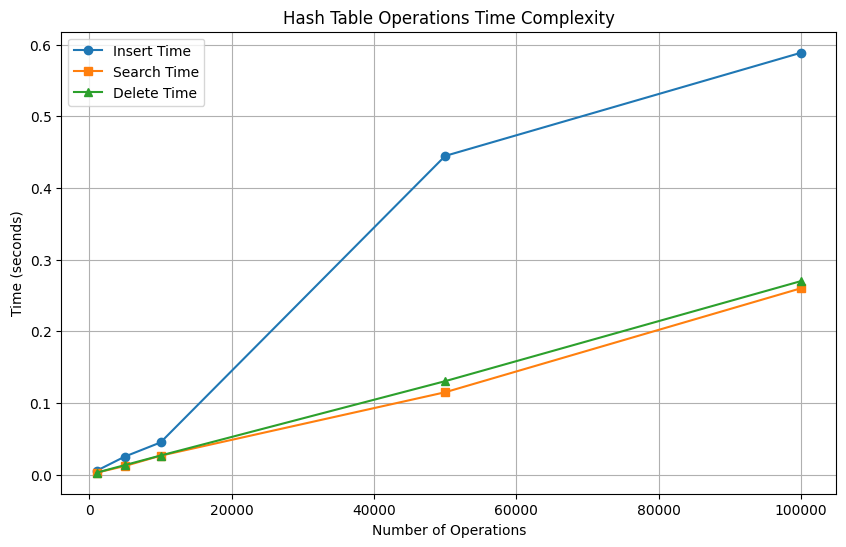

In [17]:
import time
import random
import matplotlib.pyplot as plt

# Define a benchmark function
def benchmark(hash_table, operation_sizes):
    insert_times = []
    search_times = []
    delete_times = []

    for n_operations in operation_sizes:
        # Generate a set of random keys
        keys = [str(i) for i in range(n_operations)]
        values = [random.randint(0, 1000) for _ in range(n_operations)]

        # Benchmark insertion
        start_time = time.time()
        for i in range(n_operations):
            hash_table.insert(keys[i], values[i])
        end_time = time.time()
        insert_times.append(end_time - start_time)

        # Benchmark search
        start_time = time.time()
        for i in range(n_operations):
            hash_table.search(keys[i])
        end_time = time.time()
        search_times.append(end_time - start_time)

        # Benchmark deletion
        start_time = time.time()
        for i in range(n_operations):
            hash_table.delete(keys[i])
        end_time = time.time()
        delete_times.append(end_time - start_time)

    return insert_times, search_times, delete_times

# Plot the benchmark results
def plot_benchmark(operation_sizes, insert_times, search_times, delete_times):
    plt.figure(figsize=(10, 6))
    
    plt.plot(operation_sizes, insert_times, label="Insert Time", marker='o')
    plt.plot(operation_sizes, search_times, label="Search Time", marker='s')
    plt.plot(operation_sizes, delete_times, label="Delete Time", marker='^')

    plt.xlabel("Number of Operations")
    plt.ylabel("Time (seconds)")
    plt.title("Hash Table Operations Time Complexity")
    plt.legend()
    plt.grid(True)
    plt.show()

# Example usage
ht = HashTable(size=1024)  # Start with a larger size
operation_sizes = [1000, 5000, 10000, 50000, 100000]  # Different sizes for benchmarking
insert_times, search_times, delete_times = benchmark(ht, operation_sizes)

# Plot the results
plot_benchmark(operation_sizes, insert_times, search_times, delete_times)


In [1]:
# Criando um "conjunto" utilizando um dicionário em Python
conjunto = {}

# Inserção das palavras no "conjunto"
conjunto['maçã'] = True
conjunto['banana'] = True
conjunto['pepino'] = True

# Exibindo o conteúdo do dicionário que está sendo usado como conjunto
conjunto


{'maçã': True, 'banana': True, 'pepino': True}

In [2]:
import random

# Lista de votos inicial
votos = []

# Função para adicionar voto
def adiciona_voto(candidato):
    votos.append(candidato)

# Função para contar os votos usando um dicionário
def conta_votos(lista_votos):
    contagem = {}
    for voto in lista_votos:
        if voto in contagem:
            contagem[voto] += 1
        else:
            contagem[voto] = 1
    return contagem

# Candidatos
candidatos = ['Huguinho', 'Zezinho', 'Luizinho']

# Usando um laço de repetição e sorteando votos para cada candidato
for _ in range(100):  # Simulando 100 votos
    candidato_escolhido = random.choice(candidatos)
    adiciona_voto(candidato_escolhido)

# Contando os votos
resultado = conta_votos(votos)

# Exibindo o resultado
resultado


{'Zezinho': 33, 'Huguinho': 31, 'Luizinho': 36}

In [3]:
import random

# Função para adicionar voto diretamente na contagem de votos
def adiciona_voto_contagem(candidato, contagem):
    if candidato in contagem:
        contagem[candidato] += 1
    else:
        contagem[candidato] = 1

# Candidatos
candidatos = ['Huguinho', 'Zezinho', 'Luizinho']

# Dicionário para armazenar a contagem de votos
contagem_votos = {}

# Usando um laço de repetição para sortear e contar os votos diretamente
for _ in range(100):  # Simulando 100 votos
    candidato_escolhido = random.choice(candidatos)
    adiciona_voto_contagem(candidato_escolhido, contagem_votos)

# Exibindo o resultado final da contagem
contagem_votos


{'Huguinho': 36, 'Zezinho': 37, 'Luizinho': 27}

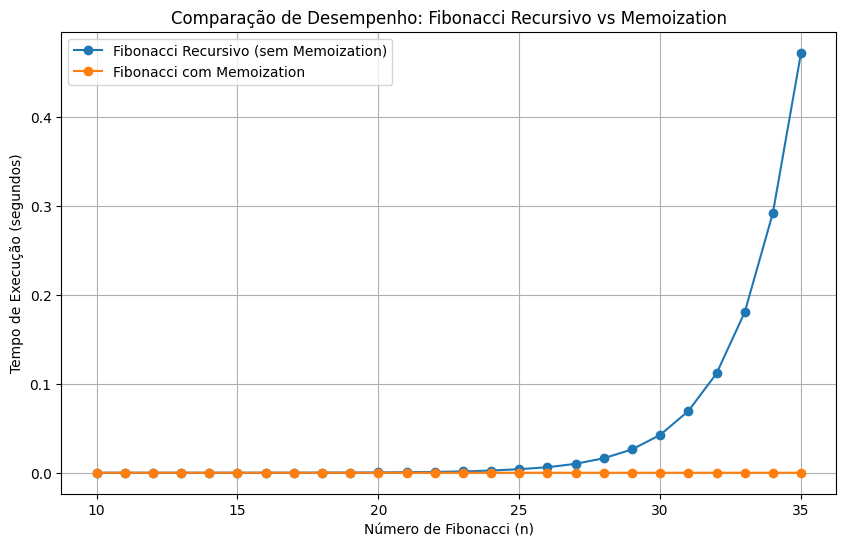

In [4]:
import time
import matplotlib.pyplot as plt

# Função recursiva de Fibonacci sem memoization
def fib_recursive(n):
    if n <= 1:
        return n
    return fib_recursive(n-1) + fib_recursive(n-2)

# Função recursiva de Fibonacci com memoization
def fib_memoization(n, memo={}):
    if n in memo:
        return memo[n]
    if n <= 1:
        memo[n] = n
        return n
    memo[n] = fib_memoization(n-1, memo) + fib_memoization(n-2, memo)
    return memo[n]

# Função para medir o tempo de execução
def measure_time(func, n):
    start_time = time.time()
    result = func(n)
    return time.time() - start_time

# Testando para vários valores de Fibonacci
fib_numbers = range(10, 36)
times_recursive = []
times_memoization = []

for n in fib_numbers:
    times_recursive.append(measure_time(fib_recursive, n))
    times_memoization.append(measure_time(fib_memoization, n))

# Gerando gráficos de comparação
plt.figure(figsize=(10, 6))
plt.plot(fib_numbers, times_recursive, label='Fibonacci Recursivo (sem Memoization)', marker='o')
plt.plot(fib_numbers, times_memoization, label='Fibonacci com Memoization', marker='o')
plt.xlabel('Número de Fibonacci (n)')
plt.ylabel('Tempo de Execução (segundos)')
plt.title('Comparação de Desempenho: Fibonacci Recursivo vs Memoization')
plt.legend()
plt.grid(True)
plt.show()
